In [1]:

# for loading/processing the images  
from keras.preprocessing.image import load_img 
from keras.preprocessing.image import img_to_array 
from keras.applications.vgg16 import preprocess_input 

# models 
from keras.applications.vgg16 import VGG16 
from keras.models import Model

# clustering and dimension reduction
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# for everything else
import os
import numpy as np
import matplotlib.pyplot as plt
from random import randint
import pandas as pd
import pickle

ModuleNotFoundError: No module named 'keras'

In [ ]:

def show_cluster(groups, iper):
  from matplotlib import pyplot as plt
  import numpy as np
  from PIL import Image

      


  for k,v in sorted(groups.items()):
    image_id_list=v
    fig,axes = plt.subplots(nrows = 1, ncols = len(image_id_list), figsize=(150,150))



    ##edit this line to include your own image ids

    if len(image_id_list)==1:
            raw_image_path='/content/sample_data/'+image_id
            raw_image = Image.open(raw_image_path)
            
            axes.imshow(raw_image)
    else:
            for i,image_id in enumerate(image_id_list):
                    raw_image_path='/content/sample_data/'+image_id
                    raw_image = Image.open(raw_image_path)
                    
                    axes[i].imshow(raw_image)
    
    title="gorup "+str(k)+ " k-means:"+ str(iper)
    plt.title(title)
    plt.show()



In [ ]:
path = "/content/sample_data"
# change the working directory to the path where the images are located
os.chdir(path)

# this list holds all the image filename
flowers = []

# creates a ScandirIterator aliased as files
with os.scandir(path) as files:
  # loops through each file in the directory
    for file in files:
        if file.name.endswith('.jpg'):
          # adds only the image files to the flowers list
            flowers.append(file.name)
            
            
            
model = VGG16()
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

def extract_features(file, model):
    # load the image as a 224x224 array
    img = load_img(file, target_size=(224,224))
    # convert from 'PIL.Image.Image' to numpy array
    img = np.array(img) 
    # reshape the data for the model reshape(num_of_samples, dim 1, dim 2, channels)
    reshaped_img = img.reshape(1,224,224,3) 
    # prepare image for model
    imgx = preprocess_input(reshaped_img)
    # get the feature vector
    features = model.predict(imgx, use_multiprocessing=True)
    return features
   
data = {}
p = r"content/sample_data/galaxy_features.pkl"

# lop through each image in the dataset
for flower in flowers:
    # try to extract the features and update the dictionary
    try:
        feat = extract_features(flower,model)
        data[flower] = feat
       
    # if something fails, save the extracted features as a pickle file (optional)
    except:
        with open(p,'wb') as file:
            pickle.dump(data,file)
          
 
# get a list of the filenames
filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))

# reshape so that there are 210 samples of 4096 vectors
feat = feat.reshape(-1,4096)

# get the unique labels (from the flower_labels.csv)
df = pd.read_csv('filename_mapping.csv')
label = df['asset_id'].tolist()
unique_labels = list(set(label))

# reduce the amount of dimensions in the feature vector
#per visualizzazione riduco a due (nel procetto si utilizza %info da conservare)
pca = PCA(n_components=2)
principalComponents=pca.fit_transform(feat)
print(principalComponents)
# cluster feature vectors

        







    



[[ 24.324282    -6.1092806 ]
 [ -5.0267735   10.90712   ]
 [ 15.148432    -1.9362625 ]
 ...
 [ -3.0337746    4.0265174 ]
 [-18.864084    -0.16439715]
 [  9.385004    -6.0973496 ]]


In [ ]:
kmeans = KMeans(n_clusters=20)
kmeans.fit(principalComponents)
# holds the cluster id and the images { id: [images] }
groups = {}

for file, cluster in zip(filenames,kmeans.labels_):
        if cluster not in groups.keys():
            groups[cluster] = []
            groups[cluster].append(file)
        else:
            groups[cluster].append(file)
centorids=kmeans.cluster_centers_
print(kmeans.labels_)
print(centorids)


[18  7 12 ...  7 11 12]
[[-10.557792   -13.7544365 ]
 [ 11.68208      3.7273786 ]
 [ 16.617157   -12.284397  ]
 [-12.308411     1.4832182 ]
 [ -3.2846963   16.918547  ]
 [ -6.056199    -7.205147  ]
 [ 18.974644     1.1621567 ]
 [ -2.5015142    7.4588203 ]
 [-11.946073     8.123932  ]
 [-20.962523   -12.275338  ]
 [  6.146466    10.534203  ]
 [-20.682665     0.0978107 ]
 [ 12.764502    -4.5777483 ]
 [ 16.683603     8.372107  ]
 [-18.315657    12.750862  ]
 [ -4.468474     0.08294939]
 [  4.996685     1.4649136 ]
 [  2.3003368   -5.510217  ]
 [ 23.268599    -4.1200566 ]
 [-14.509382    -5.1668878 ]]
dict_items([(18, ['112307.jpg', '111091.jpg', '111476.jpg', '110790.jpg', '112113.jpg', '112296.jpg', '111955.jpg', '111698.jpg', '111311.jpg', '111843.jpg', '112566.jpg', '111991.jpg', '111266.jpg', '111401.jpg', '112176.jpg', '111950.jpg', '112297.jpg', '111986.jpg', '111251.jpg', '111245.jpg', '112140.jpg', '110953.jpg', '112327.jpg', '110827.jpg', '112005.jpg', '110864.jpg', '111113.jpg',

In [ ]:
#popolosità dei cluster
df=pd.DataFrame(columns=["cluster","pop"])
for k,v in groups.items():
  df1={"cluster":k, "pop":len(v)}
  df=df.append(df1,ignore_index = True)

print(df)

   cluster  pop
0       18   68
1        7   61
2       12  110
3       14   40
4       11   87
5       19   88
6        0   37
7       16  106
8        3  105
9        1   94
10       2   60
11       5   85
12       8   75
13       4   45
14      13   61
15      17   86
16       6   83
17       9   53
18      15   98
19      10   57


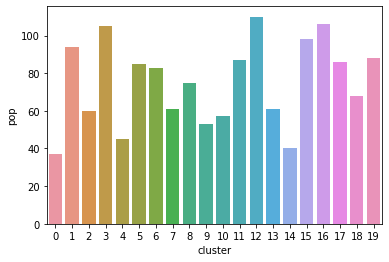

In [ ]:
import seaborn as sns
ax = sns.barplot(x="cluster", y="pop", data=df)

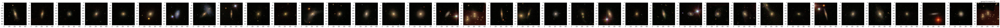

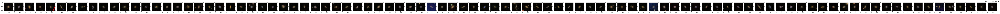

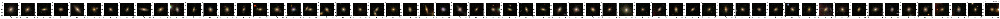

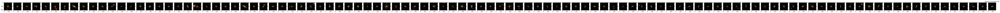

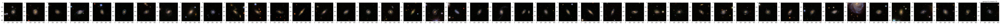

...

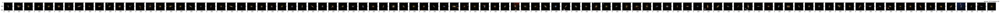

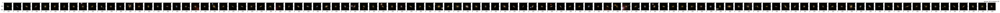

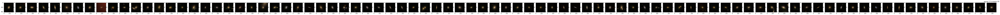

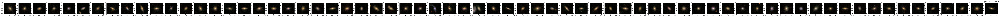

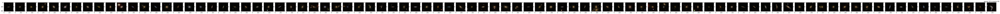

In [ ]:
show_cluster(groups,20)

In [ ]:

names = list(groups.keys())
values = list(groups.values())



In [ ]:
print(len(kmeans.labels_))
print(len(principalComponents))

1499
1499


In [ ]:
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['pc1', 'pc2'])

targets=pd.DataFrame(data=kmeans.labels_,columns=['target'])

finalDf = pd.concat([principalDf, targets], axis = 1)
print(finalDf)

            pc1        pc2  target
0     24.324282  -6.109281       7
1     -5.026773  10.907120      10
2     15.148432  -1.936262       0
3    -19.246662   7.232405       9
4    -26.279831   1.260857      11
...         ...        ...     ...
1494  -4.485442  19.959126       8
1495  19.924414   3.809354       2
1496  -3.033775   4.026517      15
1497 -18.864084  -0.164397      11
1498   9.385004  -6.097350      18

[1499 rows x 3 columns]


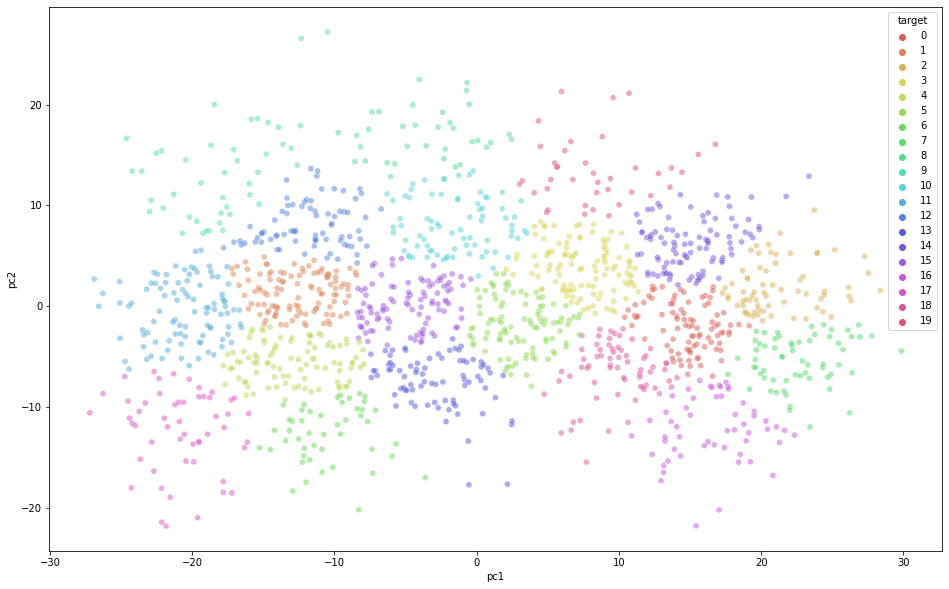

In [ ]:

#2d
import seaborn as sns
plt.figure(figsize=(16,10))
sns.scatterplot(
    x="pc1", y="pc2",
    hue="target",
    palette=sns.color_palette("hls", 20),
    data=finalDf,
    legend="full",
    alpha=0.5
)


PCA con 3 componenti


In [ ]:
path = "/content/sample_data"
# change the working directory to the path where the images are located
os.chdir(path)

# this list holds all the image filename
flowers = []

# creates a ScandirIterator aliased as files
with os.scandir(path) as files:
  # loops through each file in the directory
    for file in files:
        if file.name.endswith('.jpg'):
          # adds only the image files to the flowers list
            flowers.append(file.name)
            
            
            
model = VGG16()
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

def extract_features(file, model):
    # load the image as a 224x224 array
    img = load_img(file, target_size=(224,224))
    # convert from 'PIL.Image.Image' to numpy array
    img = np.array(img) 
    # reshape the data for the model reshape(num_of_samples, dim 1, dim 2, channels)
    reshaped_img = img.reshape(1,224,224,3) 
    # prepare image for model
    imgx = preprocess_input(reshaped_img)
    # get the feature vector
    features = model.predict(imgx, use_multiprocessing=True)
    return features
   
data = {}
p = r"content/sample_data/galaxy_features.pkl"

# lop through each image in the dataset
for flower in flowers:
    # try to extract the features and update the dictionary
    try:
        feat = extract_features(flower,model)
        data[flower] = feat
       
    # if something fails, save the extracted features as a pickle file (optional)
    except:
        with open(p,'wb') as file:
            pickle.dump(data,file)
          
 
# get a list of the filenames
filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))

# reshape so that there are 210 samples of 4096 vectors
feat = feat.reshape(-1,4096)

# get the unique labels (from the flower_labels.csv)
df = pd.read_csv('filename_mapping.csv')
label = df['asset_id'].tolist()
unique_labels = list(set(label))

# reduce the amount of dimensions in the feature vector
#per visualizzazione riduco a due (nel procetto si utilizza %info da conservare)
pca = PCA(n_components=3)
principalComponents=pca.fit_transform(feat)
print(principalComponents)


        







    



In [ ]:
'''kmeans = KMeans(n_clusters=20)
kmeans.fit(principalComponents)
# holds the cluster id and the images { id: [images] }
groups = {}

for file, cluster in zip(filenames,kmeans.labels_):
        if cluster not in groups.keys():
            groups[cluster] = []
            groups[cluster].append(file)
        else:
            groups[cluster].append(file)
centorids=kmeans.cluster_centers_
print(kmeans.labels_)
print(centorids)'''

In [ ]:
'''#popolosità dei cluster
df=pd.DataFrame(columns=["cluster","pop"])
for k,v in groups.items():
  df1={"cluster":k, "pop":len(v)}
  df=df.append(df1,ignore_index = True)

print(df)'''

In [ ]:
'''import seaborn as sns
ax = sns.barplot(x="cluster", y="pop", data=df)'''